Package installation. Run this cell if there are any packages missing. This may take around 15 minutes for installation from scratch.

In [1]:
using Pkg
Pkg.activate(".")
Pkg.resolve()
Pkg.instantiate()

  Activating project at `~/Personal/----Fisica----/_Projects/Fork/TN_2025_notes_2x1-preliminary/linearized/codes/full_linear_code`
  No Changes to `~/Personal/----Fisica----/_Projects/Fork/TN_2025_notes_2x1-preliminary/linearized/codes/full_linear_code/Project.toml`
  No Changes to `~/Personal/----Fisica----/_Projects/Fork/TN_2025_notes_2x1-preliminary/linearized/codes/full_linear_code/Manifest.toml`


The following cell includes the source code.

In [2]:
include("src/TensorDiagrams.jl");
load_config("src/2x1_specific/2x1_config.yml")
include("src/2x1_specific/boundary_processing_trees.jl");

## Diagrams processing

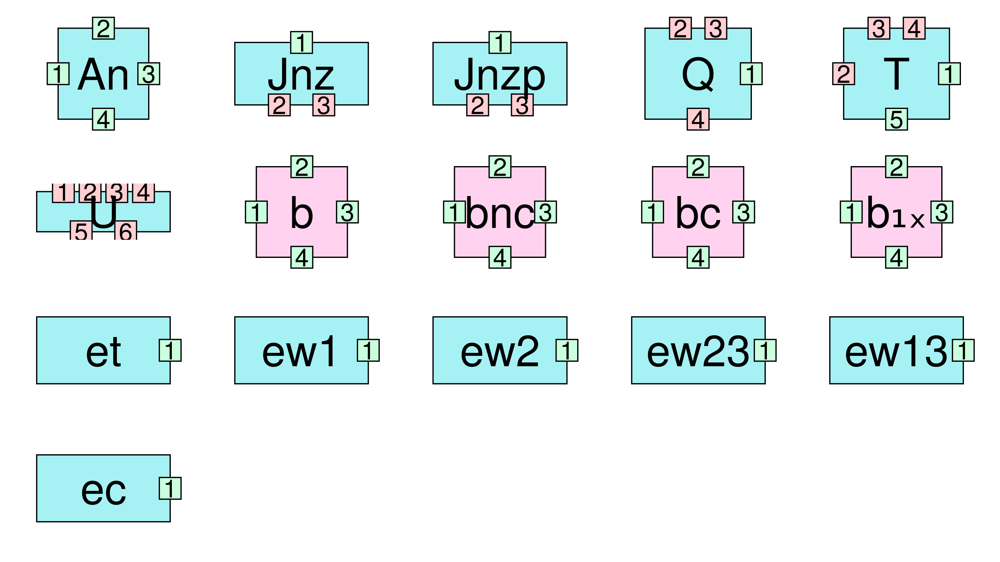

In [3]:
include("src/2x1_specific/2x1_all_nodes.jl")

In [4]:
diagrams = Vector{TensorDiagram}(undef, 12)
diags_boundary_slots_num = Dict("horizontal" => 6, "vertical" => 3);
nothing

### Group 1

In [5]:
An_1f_nd = flip(An_nd, [1]) # we need A with one index flipped in order to get TensorKit compatible code.


boundary_legs1 = Dict("left" => [-1, -2], "right" => [-5, -6], "top" => [-3, -4], "bottom" => [-7, -8])
boundary_legs_posidx1 = Dict("left" => [1, 4], "right" => [1, 4], "top" => [1, 3], "bottom" => [1, 3])

# diagrams 1,2,5,6 all have the same contraction pattern and only differ by the set of tensors and some labels

####################
# DIAGRAMS 1,2,5,6 #
####################

contraction_pattern = [[1, -3, -2, -7], [1, -4, -6, -8], [-1], [-5]]
diagrams[1] = TensorDiagram(
    nodes=[hor_reflection(An_1f_nd), b_nd, hor_reflection(et_nd), et_nd],
    contraction_pattern=contraction_pattern,
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs1,
    boundary_legs_posidx=boundary_legs_posidx1,
    labels=Dict(-6 => "z"),
    node_coordinates=[
        [-2, 0],
        [2, 0],
        [-3, -3],
        [3, -3]
    ],
    factor="1.0"
);

# second diagram is the same as the first but with different label on the right leg of b
diagrams[2] = copy(diagrams[1])
diagrams[2].labels[-6] = "r"


# fifth diagram is secretly two diagrams. Both are the same as the first but with:
# - different label on the right leg of b (u or d)
# - the right auxiliary replaced with ew1
# - factor is replaced with "1/w1"
# - b is replaced with bc (see discussion after 4.27)

diagrams[3] = copy(diagrams[1])
diagrams[3].labels[-6] = "u"
diagrams[3].nodes[4] = ew1_nd
diagrams[3].nodes[2] = bc_nd
diagrams[3].factor = "1/w1" # TODO: Should we render the factor as well?

diagrams[4] = copy(diagrams[3])
diagrams[4].labels[-6] = "d"

# diagram number 6 is again two diagrams with:
# - different label on the right leg of b (u or d)
# - tensor b replaced with bnc (b without corner contributions)
# - the right auxiliary replaced with ew23

diagrams[5] = copy(diagrams[1])
diagrams[5].labels[-6] = "u"
diagrams[5].nodes[2] = bnc_nd
diagrams[5].nodes[4] = ew23_nd

diagrams[6] = copy(diagrams[5])
diagrams[6].labels[-6] = "d"


################
# DIAGRAMS 3,4 #
################

diagrams[7] = TensorDiagram(
    nodes=[hor_reflection(An_1f_nd), An_nd, U_nd, hor_reflection(An_1f_nd), b_nd, hor_reflection(et_nd), et_nd],
    contraction_pattern=[[1, 2, -2, -7], [1, 3, -6, -8], [4, 5, 6, 7, 2, 3], [8, -3, 4, 5], [8, -4, 7, 6], [-1], [-5]],
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs1,
    boundary_legs_posidx=boundary_legs_posidx1,
    labels=Dict(-4 => "x"),
    node_coordinates=[
        [-2, -1],
        [2, -1],
        [0, 1],
        [-1, 3],
        [1, 3],
        [-3, -3],
        [3, -3]
    ],
    factor="-1.0"
);
diagrams[8] = TensorDiagram(
    nodes=[hor_reflection(An_1f_nd), An_nd, ver_reflection(U_nd), hor_reflection(An_1f_nd), b_nd, hor_reflection(et_nd), et_nd],
    contraction_pattern=[[1, -3, -2, 2], [1, -4, -6, 3], [4, 5, 6, 7, 2, 3], [8, 5, 4, -7], [8, 6, 7, -8], [-1], [-5]],
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs1,
    boundary_legs_posidx=boundary_legs_posidx1,
    labels=Dict(-8 => "x"),
    node_coordinates=[
        [-2.0, 1.0],
        [2.0, 1.0],
        [0.0, -1.0],
        [-1.0, -3.0],
        [1.0, -3.0],
        [-3.0, -3.0],
        [3.0, -3.0]],
    factor="-1.0"
);

diagrams[1:8] .= diagrams[[1, 2, 7, 8, 3, 4, 5, 6]]


diagrams_consistency = check_diagram_consistency.(diagrams[1:8]) .|> x -> all(values(x))

if !all(diagrams_consistency)
    inconsistent_indices = findall(!, diagrams_consistency)
    @warn "Diagrams $(inconsistent_indices) are inconsistent! Please use check_diagram_consistency to see details."
end

display_scrollable_figures([plot_tensor_diagram(diagrams[i]; scale=1.0) for i in 1:8], [pretty_format(diagrams[i]; pad_to=48) for i in 1:8]; max_height="800px")

<?xml version="1.0" encoding="UTF-8"?>
 
 
 
 
 
 
 
<path d="M 8.203125 -3.515625 C 8.203125 -1.296875 6.65625 0.234375 4.5 0.234375 C 1.90625 0.234375 0.6875 -1.625 0.6875 -5.171875 C 0.6875 -9.125 2.109375 -11.34375 4.75 -11.34375 C 6.484375 -11.34375 7.703125 -10.234375 7.96875 -8.390625 C 7.96875 -8.390625 6.5625 -8.390625 6.5625 -8.390625 C 6.34375 -9.46875 5.640625 -10.09375 4.65625 -10.09375 C 3.046875 -10.09375 2.140625 -8.5625 2.125 -5.796875 C 2.734375 -6.625 3.609375 -7.0625 4.734375 -7.0625 C 6.765625 -7.0625 8.203125 -5.625 8.203125 -3.515625 Z M 6.765625 -3.40625 C 6.765625 -4.921875 5.921875 -5.8125 4.5625 -5.8125 C 3.171875 -5.8125 2.203125 -4.890625 2.203125 -3.484375 C 2.203125 -2.03125 3.203125 -1.015625 4.515625 -1.015625 C 5.8125 -1.015625 6.765625 -1.984375 6.765625 -3.40625 Z M 6.765625 -3.40625 "/>
 
 
 
 
 
 
 
 
<path d="M 8.09375 -3.296875 C 8.09375 -1.15625 6.59375 0.234375 4.25 0.234375 C 1.9375 0.234375 0.6875 -0.890625 0.515625 -3.421875 C 0.515625 -3.421875 1.921875 -3.421875 1.921875 -3.421875 C 2.015625 -1.78125 2.765625 -1.015625 4.296875 -1.015625 C 5.78125 -1.015625 6.65625 -1.859375 6.65625 -3.28125 C 6.65625 -4.546875 5.859375 -5.28125 4.296875 -5.28125 C 4.296875 -5.28125 3.53125 -5.28125 3.53125 -5.28125 C 3.53125 -5.28125 3.53125 -6.46875 3.53125 -6.46875 C 5.796875 -6.46875 6.3125 -6.953125 6.3125 -8.171875 C 6.3125 -9.375 5.5625 -10.109375 4.3125 -10.109375 C 2.875 -10.109375 2.1875 -9.359375 2.15625 -7.6875 C 2.15625 -7.6875 0.75 -7.6875 0.75 -7.6875 C 0.796875 -10.09375 2.015625 -11.34375 4.296875 -11.34375 C 6.46875 -11.34375 7.765625 -10.171875 7.765625 -8.21875 C 7.765625 -7.09375 7.234375 -6.359375 6.171875 -5.9375 C 7.53125 -5.46875 8.09375 -4.671875 8.09375 -3.296875 Z M 8.09375 -3.296875 "/>
 
 
 
 
 
<path d="M 8.171875 -8.015625 C 8.171875 -6.625 7.359375 -5.4375 5.78125 -4.59375 C 5.78125 -4.59375 4.171875 -3.734375 4.171875 -3.734375 C 2.78125 -2.90625 2.265625 -2.3125 2.125 -1.390625 C 2.125 -1.390625 8.09375 -1.390625 8.09375 -1.390625 C 8.09375 -1.390625 8.09375 0 8.09375 0 C 8.09375 0 0.546875 0 0.546875 0 C 0.671875 -2.5 1.359375 -3.5625 3.734375 -4.90625 C 3.734375 -4.90625 5.203125 -5.75 5.203125 -5.75 C 6.203125 -6.3125 6.734375 -7.09375 6.734375 -7.984375 C 6.734375 -9.203125 5.78125 -10.109375 4.5 -10.109375 C 3.109375 -10.109375 2.3125 -9.3125 2.203125 -7.40625 C 2.203125 -7.40625 0.796875 -7.40625 0.796875 -7.40625 C 0.875 -10.15625 2.21875 -11.34375 4.546875 -11.34375 C 6.6875 -11.34375 8.171875 -9.9375 8.171875 -8.015625 Z M 8.171875 -8.015625 "/>
 
 
<path d="M 8.3125 -2.71875 C 8.3125 -2.71875 6.640625 -2.71875 6.640625 -2.71875 C 6.640625 -2.71875 6.640625 0 6.640625 0 C 6.640625 0 5.234375 0 5.234375 0 C 5.234375 0 5.234375 -2.71875 5.234375 -2.71875 C 5.234375 -2.71875 0.453125 -2.71875 0.453125 -2.71875 C 0.453125 -2.71875 0.453125 -4.203125 0.453125 -4.203125 C 0.453125 -4.203125 5.59375 -11.34375 5.59375 -11.34375 C 5.59375 -11.34375 6.640625 -11.34375 6.640625 -11.34375 C 6.640625 -11.34375 6.640625 -3.984375 6.640625 -3.984375 C 6.640625 -3.984375 8.3125 -3.984375 8.3125 -3.984375 C 8.3125 -3.984375 8.3125 -2.71875 8.3125 -2.71875 Z M 5.234375 -3.984375 C 5.234375 -3.984375 5.234375 -8.9375 5.234375 -8.9375 C 5.234375 -8.9375 1.6875 -3.984375 1.6875 -3.984375 C 1.6875 -3.984375 5.234375 -3.984375 5.234375 -3.984375 Z M 5.234375 -3.984375 "/>
 
 
 
 
 
<path d="M 12.546875 -6.4375 C 12.546875 -2.359375 10.390625 0.359375 7.078125 0.359375 C 5.328125 0.359375 4.0625 -0.34375 3.09375 -1.796875 C 3.09375 -1.796875 3.09375 0 3.09375 0 C 3.09375 0 1.296875 0 1.296875 0 C 1.296875 0 1.296875 -17.5 1.296875 -17.5 C 1.296875 -17.5 3.28125 -17.5 3.28125 -17.5 C 3.28125 -17.5 3.28125 -10.875 3.28125 -10.875 C 4.21875 -12.28125 5.453125 -12.9375 7.171875 -12.9375 C 10.484375 -12.9375 12.546875 -10.515625 12.546875 -6.4375 Z M 10.46875 -6.3125 C 10.46875 -9.125 9.03125 -11.0625 6.796875 -11.0625 C 4.6875 -11.15625 3.28125 -9.234375 3.28125 -6.28125 C 3.28125 

### Group 2

In [6]:
boundary_legs_2 = Dict("left" => [-1, -2], "right" => [-5, -6, -7], "top" => [-3, -4], "bottom" => [-8, -9])
diagrams[9] = TensorDiagram(
    nodes=[hor_reflection(An_nd), b_nd, T_nd, hor_reflection(et_nd), ec_nd],
    contraction_pattern=[[1, -3, -2, -8], [2, -4, -7, 3], [-6, 1, 2, 3, -9], [-1], [-5]],
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs_2,
    boundary_legs_posidx=Dict("left" => [1, 4], "right" => [1, 4, 5], "top" => [1, 3], "bottom" => [1, 3]),
    labels=Dict(-4 => "x", -7 => "u",),
    node_coordinates=[
        [-2, 0],
        [2, 2],
        [2, 0],
        [-3, -3],
        [3, -3]
    ],
    factor="1.0"
)

diagrams[10] = TensorDiagram(
    nodes=[hor_reflection(An_nd), b_nd, ver_reflection(T_nd), hor_reflection(et_nd), ec_nd],
    contraction_pattern=[[1, -3, -2, -8], [2, 3, -6, -9], [-7, 1, 2, 3, -4], [-1], [-5]],
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs_2,
    boundary_legs_posidx=Dict("left" => [1, 4], "right" => [1, 3, 4], "top" => [1, 3], "bottom" => [1, 3]),
    labels=Dict(-9 => "x", -6 => "d",),
    node_coordinates=[
        [-2, 0],
        [2, -2],
        [2, 0],
        [-3, -3],
        [3, -3]
    ],
    factor="1.0"
)


diagrams_consistency = check_diagram_consistency.(diagrams[9:10]) .|> x -> all(values(x))

if !all(diagrams_consistency)
    inconsistent_indices = 8 .+ findall(!, diagrams_consistency)
    @warn "Diagrams $(inconsistent_indices) are inconsistent! Please use check_diagram_consistency to see details."
end


display_scrollable_figures([plot_tensor_diagram(diagrams[i]; scale=1.0) for i in 9:10], [pretty_format(diagrams[i]; pad_to=48) for i in 9:10]; max_height="800px")

<?xml version="1.0" encoding="UTF-8"?>
 
 
 
 
 
 
 
 
 
 
 
 
 
<path d="M 7.71875 0 C 7.71875 0 6.515625 0 6.515625 0 C 6.515625 0 6.515625 -1.296875 6.515625 -1.296875 C 5.734375 -0.1875 4.9375 0.234375 3.71875 0.234375 C 2.078125 0.234375 1.046875 -0.65625 1.046875 -2.046875 C 1.046875 -2.046875 1.046875 -8.390625 1.046875 -8.390625 C 1.046875 -8.390625 2.375 -8.390625 2.375 -8.390625 C 2.375 -8.390625 2.375 -2.578125 2.375 -2.578125 C 2.375 -1.5625 3.046875 -0.921875 4.09375 -0.921875 C 5.484375 -0.921875 6.390625 -2.046875 6.390625 -3.765625 C 6.390625 -3.765625 6.390625 -8.390625 6.390625 -8.390625 C 6.390625 -8.390625 7.71875 -8.390625 7.71875 -8.390625 C 7.71875 -8.390625 7.71875 0 7.71875 0 Z M 7.71875 0 "/>
 
 
<path d="M 8.3125 -2.71875 C 8.3125 -2.71875 6.640625 -2.71875 6.640625 -2.71875 C 6.640625 -2.71875 6.640625 0 6.640625 0 C 6.640625 0 5.234375 0 5.234375 0 C 5.234375 0 5.234375 -2.71875 5.234375 -2.71875 C 5.234375 -2.71875 0.453125 -2.71875 0.453125 -2.71875 C 0.453125 -2.71875 0.453125 -4.203125 0.453125 -4.203125 C 0.453125 -4.203125 5.59375 -11.34375 5.59375 -11.34375 C 5.59375 -11.34375 6.640625 -11.34375 6.640625 -11.34375 C 6.640625 -11.34375 6.640625 -3.984375 6.640625 -3.984375 C 6.640625 -3.984375 8.3125 -3.984375 8.3125 -3.984375 C 8.3125 -3.984375 8.3125 -2.71875 8.3125 -2.71875 Z M 5.234375 -3.984375 C 5.234375 -3.984375 5.234375 -8.9375 5.234375 -8.9375 C 5.234375 -8.9375 1.6875 -3.984375 1.6875 -3.984375 C 1.6875 -3.984375 5.234375 -3.984375 5.234375 -3.984375 Z M 5.234375 -3.984375 "/>
 
 
<path d="M 7.5625 0 C 7.5625 0 6.015625 0 6.015625 0 C 6.015625 0 3.921875 -3.21875 3.921875 -3.21875 C 3.921875 -3.21875 1.796875 0 1.796875 0 C 1.796875 0 0.265625 0 0.265625 0 C 0.265625 0 3.234375 -4.265625 3.234375 -4.265625 C 3.234375 -4.265625 0.4375 -8.390625 0.4375 -8.390625 C 0.4375 -8.390625 1.953125 -8.390625 1.953125 -8.390625 C 1.953125 -8.390625 3.96875 -5.34375 3.96875 -5.34375 C 3.96875 -5.34375 5.984375 -8.390625 5.984375 -8.390625 C 5.984375 -8.390625 7.484375 -8.390625 7.484375 -8.390625 C 7.484375 -8.390625 4.671875 -4.34375 4.671875 -4.34375 C 4.671875 -4.34375 7.5625 0 7.5625 0 Z M 7.5625 0 "/>
 
 
<path d="M 8.09375 -3.296875 C 8.09375 -1.15625 6.59375 0.234375 4.25 0.234375 C 1.9375 0.234375 0.6875 -0.890625 0.515625 -3.421875 C 0.515625 -3.421875 1.921875 -3.421875 1.921875 -3.421875 C 2.015625 -1.78125 2.765625 -1.015625 4.296875 -1.015625 C 5.78125 -1.015625 6.65625 -1.859375 6.65625 -3.28125 C 6.65625 -4.546875 5.859375 -5.28125 4.296875 -5.28125 C 4.296875 -5.28125 3.53125 -5.28125 3.53125 -5.28125 C 3.53125 -5.28125 3.53125 -6.46875 3.53125 -6.46875 C 5.796875 -6.46875 6.3125 -6.953125 6.3125 -8.171875 C 6.3125 -9.375 5.5625 -10.109375 4.3125 -10.109375 C 2.875 -10.109375 2.1875 -9.359375 2.15625 -7.6875 C 2.15625 -7.6875 0.75 -7.6875 0.75 -7.6875 C 0.796875 -10.09375 2.015625 -11.34375 4.296875 -11.34375 C 6.46875 -11.34375 7.765625 -10.171875 7.765625 -8.21875 C 7.765625 -7.09375 7.234375 -6.359375 6.171875 -5.9375 C 7.53125 -5.46875 8.09375 -4.671875 8.09375 -3.296875 Z M 8.09375 -3.296875 "/>
 
 
 
 
 
<path d="M 8.171875 -8.015625 C 8.171875 -6.625 7.359375 -5.4375 5.78125 -4.59375 C 5.78125 -4.59375 4.171875 -3.734375 4.171875 -3.734375 C 2.78125 -2.90625 2.265625 -2.3125 2.125 -1.390625 C 2.125 -1.390625 8.09375 -1.390625 8.09375 -1.390625 C 8.09375 -1.390625 8.09375 0 8.09375 0 C 8.09375 0 0.546875 0 0.546875 0 C 0.671875 -2.5 1.359375 -3.5625 3.734375 -4.90625 C 3.734375 -4.90625 5.203125 -5.75 5.203125 -5.75 C 6.203125 -6.3125 6.734375 -7.09375 6.734375 -7.984375 C 6.734375 -9.203125 5.78125 -10.109375 4.5 -10.109375 C 3.109375 -10.109375 2.3125 -9.3125 2.203125 -7.40625 C 2.203125 -7.40625 0.796875 -7.40625 0.796875 -7.40625 C 0.875 -10.15625 2.21875 -11.34375 4.546875 -11.34375 C 6.6875 -11.34375 8.171875 -9.9375 8.171875 -8.015625 Z M 8.171875 -8.015625 "/>
 
 
<path d="M 8.203125 -3.765625 C 8.203125 -1.359375 6.609375 0.234375 4.3125 0.234375 C 2.296875 0.2343

### Group 3

In [7]:
boundary_legs_3 = Dict("left" => [-1, -2], "right" => [-5, -6, -7, -8], "top" => [-3, -4], "bottom" => [-9, -10])
diagrams[11] = TensorDiagram(
    nodes=[hor_reflection(An_1f_nd), An_nd, Q_nd, b_nd, hor_reflection(et_nd), ew1_nd],
    contraction_pattern=[[1, -3, -2, -9], [1, 2, -6, -10], [-7, 3, 4, 2], [3, -4, -8, 4], [-1], [-5]],
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs_3,
    boundary_legs_posidx=Dict("left" => [1, 4], "right" => [1, 4, 5, 6], "top" => [1, 3], "bottom" => [1, 3]),
    labels=Dict(-4 => "x", -8 => "u",),
    node_coordinates=[
        [-2, 0],
        [2, 0],
        [2, 1.8],
        [2, 3.5],
        [-3, -3],
        [3, -3]
    ],
    factor="1/w2"
)

diagrams[12] = TensorDiagram(
    nodes=[hor_reflection(An_1f_nd), An_nd, ver_reflection(Q_nd), b_nd, hor_reflection(et_nd), ew1_nd],
    contraction_pattern=[[1, -3, -2, -9], [1, -4, -8, 2], [-7, 3, 4, 2], [3, 4, -6, -10], [-1], [-5]],
    boundary_slots_num=diags_boundary_slots_num,
    boundary_legs=boundary_legs_3,
    boundary_legs_posidx=Dict("left" => [1, 4], "right" => [1, 2, 3, 4], "top" => [1, 3], "bottom" => [1, 3]),
    labels=Dict(-10 => "x", -6 => "d",),
    node_coordinates=[
        [-2, 0],
        [2, 0],
        [2, -1.8],
        [2, -3.5],
        [-3, -3],
        [3.5, -4]
    ],
    factor="1/w2"
)

diagrams_consistency = check_diagram_consistency.(diagrams[11:12]) .|> x -> all(values(x))

if !all(diagrams_consistency)
    inconsistent_indices = 10 .+ findall(!, diagrams_consistency)
    @warn "Diagrams $(inconsistent_indices) are inconsistent! Please use check_diagram_consistency to see details."
end

display_scrollable_figures([plot_tensor_diagram(diagrams[i]; scale=1.0) for i in 11:12], [pretty_format(diagrams[i]; pad_to=48) for i in 11:12]; max_height="800px")

<?xml version="1.0" encoding="UTF-8"?>
 
 
 
 
 
 
 
<path d="M 8.203125 -3.203125 C 8.203125 -1.140625 6.640625 0.234375 4.40625 0.234375 C 2.15625 0.234375 0.59375 -1.140625 0.59375 -3.21875 C 0.59375 -4.46875 1.234375 -5.34375 2.53125 -5.96875 C 1.375 -6.6875 0.984375 -7.265625 0.984375 -8.3125 C 0.984375 -10.09375 2.40625 -11.34375 4.40625 -11.34375 C 6.421875 -11.34375 7.8125 -10.09375 7.8125 -8.3125 C 7.8125 -7.25 7.421875 -6.671875 6.25 -5.96875 C 7.5625 -5.34375 8.203125 -4.46875 8.203125 -3.203125 Z M 6.375 -8.28125 C 6.375 -9.390625 5.59375 -10.09375 4.40625 -10.09375 C 3.21875 -10.09375 2.4375 -9.390625 2.4375 -8.296875 C 2.4375 -7.234375 3.21875 -6.53125 4.40625 -6.53125 C 5.578125 -6.53125 6.375 -7.234375 6.375 -8.28125 Z M 6.765625 -3.1875 C 6.765625 -4.515625 5.8125 -5.34375 4.40625 -5.34375 C 2.984375 -5.34375 2.03125 -4.515625 2.03125 -3.1875 C 2.03125 -1.859375 2.984375 -1.015625 4.375 -1.015625 C 5.8125 -1.015625 6.765625 -1.84375 6.765625 -3.1875 Z M 6.765625 -3.1875 "/>
 
 
 
 
 
<path d="M 7.71875 0 C 7.71875 0 6.515625 0 6.515625 0 C 6.515625 0 6.515625 -1.296875 6.515625 -1.296875 C 5.734375 -0.1875 4.9375 0.234375 3.71875 0.234375 C 2.078125 0.234375 1.046875 -0.65625 1.046875 -2.046875 C 1.046875 -2.046875 1.046875 -8.390625 1.046875 -8.390625 C 1.046875 -8.390625 2.375 -8.390625 2.375 -8.390625 C 2.375 -8.390625 2.375 -2.578125 2.375 -2.578125 C 2.375 -1.5625 3.046875 -0.921875 4.09375 -0.921875 C 5.484375 -0.921875 6.390625 -2.046875 6.390625 -3.765625 C 6.390625 -3.765625 6.390625 -8.390625 6.390625 -8.390625 C 6.390625 -8.390625 7.71875 -8.390625 7.71875 -8.390625 C 7.71875 -8.390625 7.71875 0 7.71875 0 Z M 7.71875 0 "/>
 
 
<path d="M 8.3125 -2.71875 C 8.3125 -2.71875 6.640625 -2.71875 6.640625 -2.71875 C 6.640625 -2.71875 6.640625 0 6.640625 0 C 6.640625 0 5.234375 0 5.234375 0 C 5.234375 0 5.234375 -2.71875 5.234375 -2.71875 C 5.234375 -2.71875 0.453125 -2.71875 0.453125 -2.71875 C 0.453125 -2.71875 0.453125 -4.203125 0.453125 -4.203125 C 0.453125 -4.203125 5.59375 -11.34375 5.59375 -11.34375 C 5.59375 -11.34375 6.640625 -11.34375 6.640625 -11.34375 C 6.640625 -11.34375 6.640625 -3.984375 6.640625 -3.984375 C 6.640625 -3.984375 8.3125 -3.984375 8.3125 -3.984375 C 8.3125 -3.984375 8.3125 -2.71875 8.3125 -2.71875 Z M 5.234375 -3.984375 C 5.234375 -3.984375 5.234375 -8.9375 5.234375 -8.9375 C 5.234375 -8.9375 1.6875 -3.984375 1.6875 -3.984375 C 1.6875 -3.984375 5.234375 -3.984375 5.234375 -3.984375 Z M 5.234375 -3.984375 "/>
 
 
<path d="M 7.5625 0 C 7.5625 0 6.015625 0 6.015625 0 C 6.015625 0 3.921875 -3.21875 3.921875 -3.21875 C 3.921875 -3.21875 1.796875 0 1.796875 0 C 1.796875 0 0.265625 0 0.265625 0 C 0.265625 0 3.234375 -4.265625 3.234375 -4.265625 C 3.234375 -4.265625 0.4375 -8.390625 0.4375 -8.390625 C 0.4375 -8.390625 1.953125 -8.390625 1.953125 -8.390625 C 1.953125 -8.390625 3.96875 -5.34375 3.96875 -5.34375 C 3.96875 -5.34375 5.984375 -8.390625 5.984375 -8.390625 C 5.984375 -8.390625 7.484375 -8.390625 7.484375 -8.390625 C 7.484375 -8.390625 4.671875 -4.34375 4.671875 -4.34375 C 4.671875 -4.34375 7.5625 0 7.5625 0 Z M 7.5625 0 "/>
 
 
<path d="M 8.09375 -3.296875 C 8.09375 -1.15625 6.59375 0.234375 4.25 0.234375 C 1.9375 0.234375 0.6875 -0.890625 0.515625 -3.421875 C 0.515625 -3.421875 1.921875 -3.421875 1.921875 -3.421875 C 2.015625 -1.78125 2.765625 -1.015625 4.296875 -1.015625 C 5.78125 -1.015625 6.65625 -1.859375 6.65625 -3.28125 C 6.65625 -4.546875 5.859375 -5.28125 4.296875 -5.28125 C 4.296875 -5.28125 3.53125 -5.28125 3.53125 -5.28125 C 3.53125 -5.28125 3.53125 -6.46875 3.53125 -6.46875 C 5.796875 -6.46875 6.3125 -6.953125 6.3125 -8.171875 C 6.3125 -9.375 5.5625 -10.109375 4.3125 -10.109375 C 2.875 -10.109375 2.1875 -9.359375 2.15625 -7.6875 C 2.15625 -7.6875 0.75 -7.6875 0.75 -7.6875 C 0.796875 -10.09375 2.015625 -11.34375 4.296875 -11.34375 C 6.46875 -11.34375 7.765625 -10.171875 7.765625 -8.21875 C 7.765625 -7.09375 7.234375 -6.359375 6.171875 -5.9375 C 7.53125 -5.46875 8.0937

### Reflections

In [11]:
reflected_diagrams = reflect.(diagrams; dir="horizontal")
aux_replacements = Dict("ew1" => ew2_nd, "ew2" => ew1_nd, "ew13" => ew23_nd, "ew23" => ew13_nd)


for diag in reflected_diagrams
    for i in eachindex(diag.nodes)
        if haskey(aux_replacements, diag.nodes[i].name)
            rep = aux_replacements[diag.nodes[i].name]
            if diag.nodes[i].hor_ref
                rep = hor_reflection(rep)
            end
            if diag.nodes[i].ver_ref
                rep = ver_reflection(rep)
            end
            diag.nodes[i] = rep
        end
    end
end
diagrams = vcat(diagrams, reflected_diagrams)


diagrams_consistency = check_diagram_consistency.(diagrams) .|> x -> all(values(x))

if !all(diagrams_consistency)
    inconsistent_indices = findall(!, diagrams_consistency)
    @warn "Diagrams $(inconsistent_indices) are inconsistent! Please use check_diagram_consistency to see details."
end


display_scrollable_figures([plot_tensor_diagram(diagrams[i]; scale=1.0) for i in 1:12], [plot_tensor_diagram(reflected_diagrams[i]; scale=1.0) for i in 1:12]; max_height="800px")

<?xml version="1.0" encoding="UTF-8"?>
 
 
 
 
 
 
 
<path d="M 8.203125 -3.515625 C 8.203125 -1.296875 6.65625 0.234375 4.5 0.234375 C 1.90625 0.234375 0.6875 -1.625 0.6875 -5.171875 C 0.6875 -9.125 2.109375 -11.34375 4.75 -11.34375 C 6.484375 -11.34375 7.703125 -10.234375 7.96875 -8.390625 C 7.96875 -8.390625 6.5625 -8.390625 6.5625 -8.390625 C 6.34375 -9.46875 5.640625 -10.09375 4.65625 -10.09375 C 3.046875 -10.09375 2.140625 -8.5625 2.125 -5.796875 C 2.734375 -6.625 3.609375 -7.0625 4.734375 -7.0625 C 6.765625 -7.0625 8.203125 -5.625 8.203125 -3.515625 Z M 6.765625 -3.40625 C 6.765625 -4.921875 5.921875 -5.8125 4.5625 -5.8125 C 3.171875 -5.8125 2.203125 -4.890625 2.203125 -3.484375 C 2.203125 -2.03125 3.203125 -1.015625 4.515625 -1.015625 C 5.8125 -1.015625 6.765625 -1.984375 6.765625 -3.40625 Z M 6.765625 -3.40625 "/>
 
 
 
 
 
 
 
 
<path d="M 8.09375 -3.296875 C 8.09375 -1.15625 6.59375 0.234375 4.25 0.234375 C 1.9375 0.234375 0.6875 -0.890625 0.515625 -3.421875 C 0.515625 -3.421875 1.921875 -3.421875 1.921875 -3.421875 C 2.015625 -1.78125 2.765625 -1.015625 4.296875 -1.015625 C 5.78125 -1.015625 6.65625 -1.859375 6.65625 -3.28125 C 6.65625 -4.546875 5.859375 -5.28125 4.296875 -5.28125 C 4.296875 -5.28125 3.53125 -5.28125 3.53125 -5.28125 C 3.53125 -5.28125 3.53125 -6.46875 3.53125 -6.46875 C 5.796875 -6.46875 6.3125 -6.953125 6.3125 -8.171875 C 6.3125 -9.375 5.5625 -10.109375 4.3125 -10.109375 C 2.875 -10.109375 2.1875 -9.359375 2.15625 -7.6875 C 2.15625 -7.6875 0.75 -7.6875 0.75 -7.6875 C 0.796875 -10.09375 2.015625 -11.34375 4.296875 -11.34375 C 6.46875 -11.34375 7.765625 -10.171875 7.765625 -8.21875 C 7.765625 -7.09375 7.234375 -6.359375 6.171875 -5.9375 C 7.53125 -5.46875 8.09375 -4.671875 8.09375 -3.296875 Z M 8.09375 -3.296875 "/>
 
 
 
 
 
<path d="M 8.171875 -8.015625 C 8.171875 -6.625 7.359375 -5.4375 5.78125 -4.59375 C 5.78125 -4.59375 4.171875 -3.734375 4.171875 -3.734375 C 2.78125 -2.90625 2.265625 -2.3125 2.125 -1.390625 C 2.125 -1.390625 8.09375 -1.390625 8.09375 -1.390625 C 8.09375 -1.390625 8.09375 0 8.09375 0 C 8.09375 0 0.546875 0 0.546875 0 C 0.671875 -2.5 1.359375 -3.5625 3.734375 -4.90625 C 3.734375 -4.90625 5.203125 -5.75 5.203125 -5.75 C 6.203125 -6.3125 6.734375 -7.09375 6.734375 -7.984375 C 6.734375 -9.203125 5.78125 -10.109375 4.5 -10.109375 C 3.109375 -10.109375 2.3125 -9.3125 2.203125 -7.40625 C 2.203125 -7.40625 0.796875 -7.40625 0.796875 -7.40625 C 0.875 -10.15625 2.21875 -11.34375 4.546875 -11.34375 C 6.6875 -11.34375 8.171875 -9.9375 8.171875 -8.015625 Z M 8.171875 -8.015625 "/>
 
 
<path d="M 8.3125 -2.71875 C 8.3125 -2.71875 6.640625 -2.71875 6.640625 -2.71875 C 6.640625 -2.71875 6.640625 0 6.640625 0 C 6.640625 0 5.234375 0 5.234375 0 C 5.234375 0 5.234375 -2.71875 5.234375 -2.71875 C 5.234375 -2.71875 0.453125 -2.71875 0.453125 -2.71875 C 0.453125 -2.71875 0.453125 -4.203125 0.453125 -4.203125 C 0.453125 -4.203125 5.59375 -11.34375 5.59375 -11.34375 C 5.59375 -11.34375 6.640625 -11.34375 6.640625 -11.34375 C 6.640625 -11.34375 6.640625 -3.984375 6.640625 -3.984375 C 6.640625 -3.984375 8.3125 -3.984375 8.3125 -3.984375 C 8.3125 -3.984375 8.3125 -2.71875 8.3125 -2.71875 Z M 5.234375 -3.984375 C 5.234375 -3.984375 5.234375 -8.9375 5.234375 -8.9375 C 5.234375 -8.9375 1.6875 -3.984375 1.6875 -3.984375 C 1.6875 -3.984375 5.234375 -3.984375 5.234375 -3.984375 Z M 5.234375 -3.984375 "/>
 
 
 
 
 
<path d="M 12.546875 -6.4375 C 12.546875 -2.359375 10.390625 0.359375 7.078125 0.359375 C 5.328125 0.359375 4.0625 -0.34375 3.09375 -1.796875 C 3.09375 -1.796875 3.09375 0 3.09375 0 C 3.09375 0 1.296875 0 1.296875 0 C 1.296875 0 1.296875 -17.5 1.296875 -17.5 C 1.296875 -17.5 3.28125 -17.5 3.28125 -17.5 C 3.28125 -17.5 3.28125 -10.875 3.28125 -10.875 C 4.21875 -12.28125 5.453125 -12.9375 7.171875 -12.9375 C 10.484375 -12.9375 12.546875 -10.515625 12.546875 -6.4375 Z M 10.46875 -6.3125 C 10.46875 -9.125 9.03125 -11.0625 6.796875 -11.0625 C 4.6875 -11.15625 3.28125 -9.234375 3.28125 -6.28125 C 3.28125 

### Labels completion

In [12]:
diagrams_filled = fill_labels.(diagrams)

for diag_list in diagrams_filled
    for diag in diag_list
        bnc_pos = findall(x -> x.name == "bnc", diag.nodes)
        if !isempty(bnc_pos)
            for i in bnc_pos
                rep = b_nd
                if diag.nodes[i].hor_ref
                    rep = hor_reflection(rep)
                end
                if diag.nodes[i].ver_ref
                    rep = ver_reflection(rep)
                end
                diag.nodes[i] = rep
            end
        end

        bc_pos = findall(x -> x.name == "bc", diag.nodes)
        if !isempty(bc_pos)
            for i in bc_pos
                rep = b_nd
                if diag.nodes[i].hor_ref
                    rep = hor_reflection(rep)
                end
                if diag.nodes[i].ver_ref
                    rep = ver_reflection(rep)
                end
                diag.nodes[i] = rep
            end
        end

    end
end

columns_num = maximum(length.(diagrams_filled)) + 1
columns = Vector{Union{Figure,Missing}}[[plot_tensor_diagram(diagrams[i]; scale=1.0) for i in eachindex(diagrams)]]
for c in 1:columns_num-1
    column = []
    for dlist in diagrams_filled
        if length(dlist) >= c
            push!(column, plot_tensor_diagram(dlist[c]; scale=1.0))
        else
            push!(column, missing)
        end
    end
    push!(columns, column)
end
columns .|> length
diagrams_filled_flat = vcat(diagrams_filled...)

diagrams_consistency = all.(values.(check_diagram_consistency.(diagrams_filled_flat)))

if !all(diagrams_consistency)
    inconsistent_indices = findall(!, diagrams_consistency)
    @warn "Labeled diagrams $(inconsistent_indices) are inconsistent! Please use check_diagram_consistency to see details."

end

display_scrollable_figures(columns...; max_height="800px")

<?xml version="1.0" encoding="UTF-8"?>
 
 
 
 
 
 
 
<path d="M 8.203125 -3.515625 C 8.203125 -1.296875 6.65625 0.234375 4.5 0.234375 C 1.90625 0.234375 0.6875 -1.625 0.6875 -5.171875 C 0.6875 -9.125 2.109375 -11.34375 4.75 -11.34375 C 6.484375 -11.34375 7.703125 -10.234375 7.96875 -8.390625 C 7.96875 -8.390625 6.5625 -8.390625 6.5625 -8.390625 C 6.34375 -9.46875 5.640625 -10.09375 4.65625 -10.09375 C 3.046875 -10.09375 2.140625 -8.5625 2.125 -5.796875 C 2.734375 -6.625 3.609375 -7.0625 4.734375 -7.0625 C 6.765625 -7.0625 8.203125 -5.625 8.203125 -3.515625 Z M 6.765625 -3.40625 C 6.765625 -4.921875 5.921875 -5.8125 4.5625 -5.8125 C 3.171875 -5.8125 2.203125 -4.890625 2.203125 -3.484375 C 2.203125 -2.03125 3.203125 -1.015625 4.515625 -1.015625 C 5.8125 -1.015625 6.765625 -1.984375 6.765625 -3.40625 Z M 6.765625 -3.40625 "/>
 
 
 
 
 
 
 
 
<path d="M 8.09375 -3.296875 C 8.09375 -1.15625 6.59375 0.234375 4.25 0.234375 C 1.9375 0.234375 0.6875 -0.890625 0.515625 -3.421875 C 0.515625 -3.421875 1.921875 -3.421875 1.921875 -3.421875 C 2.015625 -1.78125 2.765625 -1.015625 4.296875 -1.015625 C 5.78125 -1.015625 6.65625 -1.859375 6.65625 -3.28125 C 6.65625 -4.546875 5.859375 -5.28125 4.296875 -5.28125 C 4.296875 -5.28125 3.53125 -5.28125 3.53125 -5.28125 C 3.53125 -5.28125 3.53125 -6.46875 3.53125 -6.46875 C 5.796875 -6.46875 6.3125 -6.953125 6.3125 -8.171875 C 6.3125 -9.375 5.5625 -10.109375 4.3125 -10.109375 C 2.875 -10.109375 2.1875 -9.359375 2.15625 -7.6875 C 2.15625 -7.6875 0.75 -7.6875 0.75 -7.6875 C 0.796875 -10.09375 2.015625 -11.34375 4.296875 -11.34375 C 6.46875 -11.34375 7.765625 -10.171875 7.765625 -8.21875 C 7.765625 -7.09375 7.234375 -6.359375 6.171875 -5.9375 C 7.53125 -5.46875 8.09375 -4.671875 8.09375 -3.296875 Z M 8.09375 -3.296875 "/>
 
 
 
 
 
<path d="M 8.171875 -8.015625 C 8.171875 -6.625 7.359375 -5.4375 5.78125 -4.59375 C 5.78125 -4.59375 4.171875 -3.734375 4.171875 -3.734375 C 2.78125 -2.90625 2.265625 -2.3125 2.125 -1.390625 C 2.125 -1.390625 8.09375 -1.390625 8.09375 -1.390625 C 8.09375 -1.390625 8.09375 0 8.09375 0 C 8.09375 0 0.546875 0 0.546875 0 C 0.671875 -2.5 1.359375 -3.5625 3.734375 -4.90625 C 3.734375 -4.90625 5.203125 -5.75 5.203125 -5.75 C 6.203125 -6.3125 6.734375 -7.09375 6.734375 -7.984375 C 6.734375 -9.203125 5.78125 -10.109375 4.5 -10.109375 C 3.109375 -10.109375 2.3125 -9.3125 2.203125 -7.40625 C 2.203125 -7.40625 0.796875 -7.40625 0.796875 -7.40625 C 0.875 -10.15625 2.21875 -11.34375 4.546875 -11.34375 C 6.6875 -11.34375 8.171875 -9.9375 8.171875 -8.015625 Z M 8.171875 -8.015625 "/>
 
 
<path d="M 8.3125 -2.71875 C 8.3125 -2.71875 6.640625 -2.71875 6.640625 -2.71875 C 6.640625 -2.71875 6.640625 0 6.640625 0 C 6.640625 0 5.234375 0 5.234375 0 C 5.234375 0 5.234375 -2.71875 5.234375 -2.71875 C 5.234375 -2.71875 0.453125 -2.71875 0.453125 -2.71875 C 0.453125 -2.71875 0.453125 -4.203125 0.453125 -4.203125 C 0.453125 -4.203125 5.59375 -11.34375 5.59375 -11.34375 C 5.59375 -11.34375 6.640625 -11.34375 6.640625 -11.34375 C 6.640625 -11.34375 6.640625 -3.984375 6.640625 -3.984375 C 6.640625 -3.984375 8.3125 -3.984375 8.3125 -3.984375 C 8.3125 -3.984375 8.3125 -2.71875 8.3125 -2.71875 Z M 5.234375 -3.984375 C 5.234375 -3.984375 5.234375 -8.9375 5.234375 -8.9375 C 5.234375 -8.9375 1.6875 -3.984375 1.6875 -3.984375 C 1.6875 -3.984375 5.234375 -3.984375 5.234375 -3.984375 Z M 5.234375 -3.984375 "/>
 
 
 
 
 
<path d="M 12.546875 -6.4375 C 12.546875 -2.359375 10.390625 0.359375 7.078125 0.359375 C 5.328125 0.359375 4.0625 -0.34375 3.09375 -1.796875 C 3.09375 -1.796875 3.09375 0 3.09375 0 C 3.09375 0 1.296875 0 1.296875 0 C 1.296875 0 1.296875 -17.5 1.296875 -17.5 C 1.296875 -17.5 3.28125 -17.5 3.28125 -17.5 C 3.28125 -17.5 3.28125 -10.875 3.28125 -10.875 C 4.21875 -12.28125 5.453125 -12.9375 7.171875 -12.9375 C 10.484375 -12.9375 12.546875 -10.515625 12.546875 -6.4375 Z M 10.46875 -6.3125 C 10.46875 -9.125 9.03125 -11.0625 6.796875 -11.0625 C 4.6875 -11.15625 3.28125 -9.234375 3.28125 -6.28125 C 3.28125 

### J tensor gluing

In [13]:
Jnz_diag = TensorDiagram(
    nodes=[Jn_z_nd],
    contraction_pattern=[[-1, -2, -3]],
    boundary_slots_num=Dict("vertical" => 3, "horizontal" => 0),
    boundary_legs=Dict("top" => [-1], "bottom" => [-2, -3]),
    boundary_legs_posidx=Dict("top" => [2], "bottom" => [1, 3]),
    labels=Dict(-1 => "z", -2 => "z", -3 => "z"),
    node_coordinates=[[0, -1]],
    width=5,
    height=2
)

Jnzp_diag = TensorDiagram(
    nodes=[Jn_zp_nd],
    contraction_pattern=[[-1, -2, -3]],
    boundary_slots_num=Dict("vertical" => 3, "horizontal" => 0),
    boundary_legs=Dict("top" => [-1], "bottom" => [-2, -3]),
    boundary_legs_posidx=Dict("top" => [2], "bottom" => [1, 3]),
    labels=Dict(-1 => "z'", -2 => "z", -3 => "z"),
    node_coordinates=[[0, -1]],
    width=5,
    height=2
)

for idx in eachindex(diagrams_filled)
    new_list = TensorDiagram[]
    for diag in diagrams_filled[idx]
        new_diags = TensorDiagram[]
        tmp_diags = TensorDiagram[diag]


        top_legs = diag.boundary_legs["top"]
        bottom_legs = diag.boundary_legs["bottom"]

        top_labels = [diag.labels[i] for i in top_legs]
        bottom_labels = [diag.labels[i] for i in bottom_legs]

        if top_labels == ["z", "z"]
            tmp_diags = [
                glue_diagrams(diag, Jnz_diag, ["top", "bottom"]),
                glue_diagrams(diag, Jnzp_diag, ["top", "bottom"])
            ]
        end

        if bottom_labels == ["z", "z"]
            for diag in tmp_diags
                push!(new_diags,
                    glue_diagrams(diag, Jnz_diag, ["bottom", "bottom"])
                )
                push!(new_diags,
                    glue_diagrams(diag, Jnzp_diag, ["bottom", "bottom"])
                )
            end
        else
            new_diags = tmp_diags
        end
        append!(new_list, new_diags)
    end
    diagrams_filled[idx] = new_list
end


diagrams_filled_flat = vcat(diagrams_filled...)

diagrams_consistency = all.(values.(check_diagram_consistency.(diagrams_filled_flat)))

if !all(diagrams_consistency)
    inconsistent_indices = findall(!, diagrams_consistency)
    @warn "Labeled diagrams $(inconsistent_indices) are inconsistent! Please use check_diagram_consistency to see details."

end

columns_num = maximum(length.(diagrams_filled)) + 1
columns = Vector{Union{Figure,Missing}}[[plot_tensor_diagram(diagrams[i]; scale=1.0) for i in eachindex(diagrams)]]
for c in 1:columns_num-1
    column = []
    for dlist in diagrams_filled
        if length(dlist) >= c
            push!(column, plot_tensor_diagram(dlist[c]; scale=1.0))
        else
            push!(column, missing)
        end
    end
    push!(columns, column)
end
columns .|> length


display_scrollable_figures(columns...; max_height="800px")

<?xml version="1.0" encoding="UTF-8"?>
 
 
 
 
 
 
 
<path d="M 8.203125 -3.515625 C 8.203125 -1.296875 6.65625 0.234375 4.5 0.234375 C 1.90625 0.234375 0.6875 -1.625 0.6875 -5.171875 C 0.6875 -9.125 2.109375 -11.34375 4.75 -11.34375 C 6.484375 -11.34375 7.703125 -10.234375 7.96875 -8.390625 C 7.96875 -8.390625 6.5625 -8.390625 6.5625 -8.390625 C 6.34375 -9.46875 5.640625 -10.09375 4.65625 -10.09375 C 3.046875 -10.09375 2.140625 -8.5625 2.125 -5.796875 C 2.734375 -6.625 3.609375 -7.0625 4.734375 -7.0625 C 6.765625 -7.0625 8.203125 -5.625 8.203125 -3.515625 Z M 6.765625 -3.40625 C 6.765625 -4.921875 5.921875 -5.8125 4.5625 -5.8125 C 3.171875 -5.8125 2.203125 -4.890625 2.203125 -3.484375 C 2.203125 -2.03125 3.203125 -1.015625 4.515625 -1.015625 C 5.8125 -1.015625 6.765625 -1.984375 6.765625 -3.40625 Z M 6.765625 -3.40625 "/>
 
 
 
 
 
 
 
 
<path d="M 8.09375 -3.296875 C 8.09375 -1.15625 6.59375 0.234375 4.25 0.234375 C 1.9375 0.234375 0.6875 -0.890625 0.515625 -3.421875 C 0.515625 -3.421875 1.921875 -3.421875 1.921875 -3.421875 C 2.015625 -1.78125 2.765625 -1.015625 4.296875 -1.015625 C 5.78125 -1.015625 6.65625 -1.859375 6.65625 -3.28125 C 6.65625 -4.546875 5.859375 -5.28125 4.296875 -5.28125 C 4.296875 -5.28125 3.53125 -5.28125 3.53125 -5.28125 C 3.53125 -5.28125 3.53125 -6.46875 3.53125 -6.46875 C 5.796875 -6.46875 6.3125 -6.953125 6.3125 -8.171875 C 6.3125 -9.375 5.5625 -10.109375 4.3125 -10.109375 C 2.875 -10.109375 2.1875 -9.359375 2.15625 -7.6875 C 2.15625 -7.6875 0.75 -7.6875 0.75 -7.6875 C 0.796875 -10.09375 2.015625 -11.34375 4.296875 -11.34375 C 6.46875 -11.34375 7.765625 -10.171875 7.765625 -8.21875 C 7.765625 -7.09375 7.234375 -6.359375 6.171875 -5.9375 C 7.53125 -5.46875 8.09375 -4.671875 8.09375 -3.296875 Z M 8.09375 -3.296875 "/>
 
 
 
 
 
<path d="M 8.171875 -8.015625 C 8.171875 -6.625 7.359375 -5.4375 5.78125 -4.59375 C 5.78125 -4.59375 4.171875 -3.734375 4.171875 -3.734375 C 2.78125 -2.90625 2.265625 -2.3125 2.125 -1.390625 C 2.125 -1.390625 8.09375 -1.390625 8.09375 -1.390625 C 8.09375 -1.390625 8.09375 0 8.09375 0 C 8.09375 0 0.546875 0 0.546875 0 C 0.671875 -2.5 1.359375 -3.5625 3.734375 -4.90625 C 3.734375 -4.90625 5.203125 -5.75 5.203125 -5.75 C 6.203125 -6.3125 6.734375 -7.09375 6.734375 -7.984375 C 6.734375 -9.203125 5.78125 -10.109375 4.5 -10.109375 C 3.109375 -10.109375 2.3125 -9.3125 2.203125 -7.40625 C 2.203125 -7.40625 0.796875 -7.40625 0.796875 -7.40625 C 0.875 -10.15625 2.21875 -11.34375 4.546875 -11.34375 C 6.6875 -11.34375 8.171875 -9.9375 8.171875 -8.015625 Z M 8.171875 -8.015625 "/>
 
 
<path d="M 8.3125 -2.71875 C 8.3125 -2.71875 6.640625 -2.71875 6.640625 -2.71875 C 6.640625 -2.71875 6.640625 0 6.640625 0 C 6.640625 0 5.234375 0 5.234375 0 C 5.234375 0 5.234375 -2.71875 5.234375 -2.71875 C 5.234375 -2.71875 0.453125 -2.71875 0.453125 -2.71875 C 0.453125 -2.71875 0.453125 -4.203125 0.453125 -4.203125 C 0.453125 -4.203125 5.59375 -11.34375 5.59375 -11.34375 C 5.59375 -11.34375 6.640625 -11.34375 6.640625 -11.34375 C 6.640625 -11.34375 6.640625 -3.984375 6.640625 -3.984375 C 6.640625 -3.984375 8.3125 -3.984375 8.3125 -3.984375 C 8.3125 -3.984375 8.3125 -2.71875 8.3125 -2.71875 Z M 5.234375 -3.984375 C 5.234375 -3.984375 5.234375 -8.9375 5.234375 -8.9375 C 5.234375 -8.9375 1.6875 -3.984375 1.6875 -3.984375 C 1.6875 -3.984375 5.234375 -3.984375 5.234375 -3.984375 Z M 5.234375 -3.984375 "/>
 
 
 
 
 
<path d="M 12.546875 -6.4375 C 12.546875 -2.359375 10.390625 0.359375 7.078125 0.359375 C 5.328125 0.359375 4.0625 -0.34375 3.09375 -1.796875 C 3.09375 -1.796875 3.09375 0 3.09375 0 C 3.09375 0 1.296875 0 1.296875 0 C 1.296875 0 1.296875 -17.5 1.296875 -17.5 C 1.296875 -17.5 3.28125 -17.5 3.28125 -17.5 C 3.28125 -17.5 3.28125 -10.875 3.28125 -10.875 C 4.21875 -12.28125 5.453125 -12.9375 7.171875 -12.9375 C 10.484375 -12.9375 12.546875 -10.515625 12.546875 -6.4375 Z M 10.46875 -6.3125 C 10.46875 -9.125 9.03125 -11.0625 6.796875 -11.0625 C 4.6875 -11.15625 3.28125 -9.234375 3.28125 -6.28125 C 3.28125 

In [26]:
using JLD2
@save "full_list_of_diagrams.jld2" diagrams_filled_flat